## <center>-: Non-Linear regression :-</center>

**Linear regression analysis is used to predict the value of a variable based on the value of another variable. The variable you want to predict is called the dependent variable. The variable you are using to predict the other variable's value is called the independent variable.**

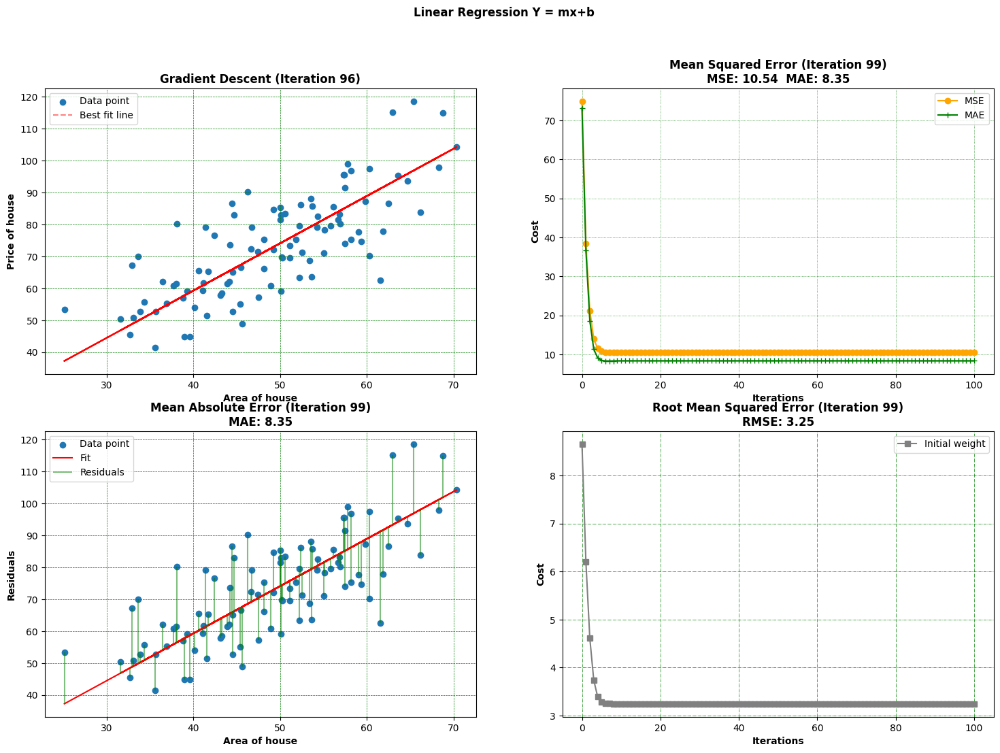

In [1]:
import pandas as pd
import numpy as np
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 50.0
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error
from matplotlib.animation import FuncAnimation
from IPython.display import display, HTML

def Gradient_descent():
    plt.rcParams['figure.figsize'] = (18.0, 12.0)  # Adjust plot size
    
    # Preprocessing Input data
    data = pd.read_csv('/Users/skmirajulislam/Documents/MyPython/Ml/Topstack/data/Mumbai_house.csv')
    X = data.iloc[:, 0]
    Y = data.iloc[:, 1]

    m = 0 #slope
    c = 0 #intercept
    L = 0.0001  # The learning Rate or Alpha | The learning rate L determines the step size of each update. 
    epochs = 100  # The number of iterations to perform gradient descent
    n = float(len(X))  # Number of elements in X 

    fig, axs = plt.subplots(2, 2)
    fig.suptitle('Linear Regression Y = mx+b' , weight='bold')

    axs[0, 0].set_title('Linear Relationship', weight='bold')
    axs[0, 0].grid()
    axs[0, 0].scatter(X, Y)

    axs[0, 1].set_title('MSE', weight='bold')
    axs[1, 0].set_title('RMSE', weight='bold')
    axs[1, 1].set_title('MAE', weight='bold')

    cost_history = []
    rmse_history = []
    mae_history = []

    def animate(i):
        nonlocal m, c
        Y_pred = m * X + c
        D_m = (-2/n) * sum(X * (Y - Y_pred))
        D_c = (-2/n) * sum(Y - Y_pred)
        m -= L * D_m
        c -= L * D_c

        ymin = np.minimum(Y, Y_pred)
        ymax = np.maximum(Y, Y_pred)

        mse = mean_squared_error(Y, Y_pred, squared=False)
        cost_history.append(mse)

        rmse = np.sqrt(mean_squared_error(Y, Y_pred, squared=False))
        rmse_history.append(rmse)

        mae = mean_absolute_error(Y, Y_pred)
        mae_history.append(mae)
        

        axs[0, 1].clear()
        axs[1, 0].clear()
        axs[1, 1].clear()

        axs[0, 1].set_title(f'Mean Squared Error (Iteration {i})\nMSE: {mse:.2f}  MAE: {mae:.2f}', weight='bold')
        axs[1, 0].set_title(f'Mean Absolute Error (Iteration {i})\nMAE: {mae:.2f}', weight='bold')
        axs[1, 1].set_title(f'Root Mean Squared Error (Iteration {i})\nRMSE: {rmse:.2f}', weight='bold')

        axs[0, 1].grid(color='green', linestyle=':', linewidth=0.5)
        axs[0, 1].plot(range(len(cost_history)), cost_history, marker='o', color="orange", label='MSE')
        axs[0, 1].plot(range(len(mae_history)),mae_history, marker='+', color="green", label='MAE')
        
        axs[0, 1].set_xlabel('Iterations', weight='bold')
        axs[0, 1].set_ylabel('Cost', weight='bold')
        axs[0, 1].legend()

        axs[1,0].grid(color='green', linestyle='--', linewidth=0.5)
        axs[1,0].scatter(X, Y , label='Data point')
        axs[1,0].plot(X, Y_pred, color='r', label='Fit')
        axs[1,0].vlines(X, ymin, ymax, 'g', alpha=0.5, label='Residuals')
        axs[1,0].set_ylabel('Residuals', weight='bold')
        axs[1,0].set_xlabel('Area of house', weight='bold')
        axs[1,0].legend()

        axs[1, 1].grid(color='green', linestyle='-.', linewidth=0.5)
        axs[1, 1].plot(range(len(rmse_history)), rmse_history, marker='s', color="gray", label='Initial weight')
        axs[1, 1].set_xlabel('Iterations', weight='bold')
        axs[1, 1].set_ylabel('Cost', weight='bold')
        axs[1, 1].legend()

        axs[0, 0].plot(X, Y_pred, color='red')

        if i % 4 == 0:
            axs[0, 0].clear()
            axs[0, 0].set_title(f'Gradient Descent (Iteration {i})', weight='bold')
            axs[0, 0].grid(color='green', linestyle='--', linewidth=0.5)
            axs[0, 0].scatter(X, Y, label='Data point')
            best_fit_x = np.array([min(X), max(X)])
            best_fit_y = m * best_fit_x + c
            axs[0, 0].plot(best_fit_x, best_fit_y, color='red', alpha=0.5, label='Best fit line', linestyle="--")
            axs[0, 0].set_ylabel('Price of house', weight='bold')
            axs[0, 0].set_xlabel('Area of house', weight='bold')
            axs[0, 0].legend()

    anim = FuncAnimation(fig, animate, frames=epochs, repeat=False)
    display(HTML(anim.to_jshtml()))

if __name__ == "__main__":
    Gradient_descent()


**Mean Absolute Error (MAE) :**

is a measure of the average size of the mistakes in a collection of predictions, without taking their direction into account. It is measured as the average absolute difference between the predicted values and the actual values and is used to assess the effectiveness of a regression model.

**Mean Squred Error (MSE):**

In statistics, the mean squared error (MSE) is a risk function that measures the square of errors. When performing regression, use MSE if you believe your target is normally distributed and you want large errors to be penalized more than small ones

**Root Mean Squared Error (RMSE) :**

The Root Mean Squared Error (RMSE) is one of the two main performance indicators for a regression model. It measures the average difference between values predicted by a model and the actual values. It provides an estimation of how well the model is able to predict the target value (accuracy).